In [107]:
import geopandas as gpd
from folium import (
    LayerControl,
    Element,
    TileLayer,
)
import plotly.express as px
from os import path



from core.downloads.geosampa import get_capabilities, get_features

# Promoção da Sustentabilidade Ambiental, Gestão de risco

## Formulário 7

O formulário associado a este notebook solicita os dados sobre 
`áreas de risco (hidrológico e deslizamentos)`. A justificativa para estes dados é a seguinte:

> As áreas de risco estão relacionadas à construção de moradias, em sua maioria em condições precárias, em locais com geológico-geotécnicas frágeis, não recomendadas para ocupação. O impacto de chuvas concentradas intensas, características de eventos climáticos extremos deve ser monitorado pelo Município, através de políticas públicas de gestão de risco e promoção da resiliência climática.

## Carregando as camadas de risco hidrológico e geológico

In [2]:
get_capabilities('hidrológico')

[{'name': 'geoportal:risco_hidrologico',
  'title': 'Risco Hidrológico',
  'abstract': 'Áreas de risco de enchentes e inundações em assentamentos precários.'}]

In [3]:
get_capabilities('deslizamento')

[{'name': 'geoportal:risco_ocorrencia_deslizamento',
  'title': 'Deslizamento',
  'abstract': 'Deslizamento.'},
 {'name': 'geoportal:area_risco_geologico',
  'title': 'Risco Geológico',
  'abstract': 'Polígonos que delimitam as áreas de risco geológico em assentamentos precários, sujeitas a deslizamentos e solapamento de margem de córrego no Município de São Paulo levantadas pelo IPT/SMSP entre 2009 e 2011.'},
 {'name': 'geoportal:risco_ocorrencia_risco_deslizamento',
  'title': 'Risco de Deslizamento',
  'abstract': 'Risco de deslizamento.'}]

Como o formulário cita apenas a camada `proteção e defesa civil/mapeamento de areas de risco`, assumirei que a referência a deslizamentos seja sobre a camada de risco geológico.

In [4]:
df_hid = get_features('geoportal:risco_hidrologico')
df_hid.head()

,id,cd_identificador_risco_hidrologico,nm_area_risco_hidrologico,tx_grau_risco_hidrologico,sg_area_risco_hidrologico,sg_setor_risco_hidrologico,tx_tipo_processo,dt_vistoria,qt_moradia,nm_subprefeitura,nm_bacia_hidrografica,geometry
0,risco_hidrologico.1,1,BARTOLOMEU FEIO,R2,HPI-01,HPI-01-01 (R2),ALAGAMENTO,2021-08-24,44,PINHEIROS,CORREGO AGUA ESPRAIADA,"POLYGON ((327424.845 7387319.281, 327417.205 7..."
1,risco_hidrologico.2,2,SAO SAVERIO,R1,HIP-02,HIP-02-02 (R1),ENCHENTE/INUNDACAO,2022-01-20,100,IPIRANGA,CORREGO OURIVES-RIBEIRAO DOS COUROS,"POLYGON ((336127.973 7383089.854, 336129.964 7..."
2,risco_hidrologico.3,3,SAO SAVERIO,R2,HIP-02,HIP-02-01 (R2),ALAGAMENTO/ENXURRADA,2022-01-20,55,IPIRANGA,CORREGO OURIVES-RIBEIRAO DOS COUROS,"POLYGON ((336230.18 7383173.982, 336238.655 73..."
3,risco_hidrologico.4,4,MONTE KEMEL,R2,HIP-03,HIP-03-01 (R2),ALAGAMENTO/ENCHENTE/INUNDACAO,2022-02-09,14,IPIRANGA,CORREGO IPIRANGA,"POLYGON ((334072.936 7385682.328, 334069.133 7..."
4,risco_hidrologico.5,5,NOVA IMIGRANTES,R2,HIP-04,HIP-04-01 (R2),ALAGAMENTO/ENCHENTE/INUNDACAO,2022-02-09,17,IPIRANGA,CORREGO IPIRANGA,"POLYGON ((333911.31 7386187.091, 333909.968 73..."


In [5]:
df_geo = get_features('geoportal:area_risco_geologico')
df_geo.head()

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,dt_vistoria,sg_fonte_original,qt_moradia,geometry
0,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-06-01 03:00:00+00:00,2022-02-02,18,0,"POLYGON ((332306.817 7380115.28, 332246.187 73..."
1,area_risco_geologico.2,2,AVENIDA SANTO AFONSO III,r2,AD-03,AD-03-02 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-02,18,3,"POLYGON ((332093.382 7380021.902, 332083.988 7..."
2,area_risco_geologico.3,3,AVENIDA SANTO AFONSO III,r1,AD-03,AD-03-01 (R1),ESCORREGAMENTO,2,1,2025-06-01 03:00:00+00:00,2022-02-02,18,80,"POLYGON ((332072.887 7379996.732, 332028.543 7..."
3,area_risco_geologico.4,4,RUA SAO BENTO XV,r3,AD-04,AD-04-03 (R3),SOLAPAMENTO,4,3,2025-06-01 03:00:00+00:00,2024-03-27,18,100,"POLYGON ((332324.725 7378882.633, 332309.159 7..."
4,area_risco_geologico.5,5,RUA SAO BENTO XV,r3,AD-04,AD-04-01 (R3),SOLAPAMENTO,4,3,2025-06-01 03:00:00+00:00,2024-03-27,18,30,"POLYGON ((332060.389 7379330.535, 332080.779 7..."


Além dos dados de riscos hidrogeológicos, também precisaremos dos dados do Censo de 2022 para a estimativa populacional. Os dados básicos, como número de domicílios e população, são disponibilizados diretamente no geopackage com as geometrias de setores censitários.

In [6]:
df_censo = gpd.read_file('https://ftp.ibge.gov.br/Censos/Censo_Demografico_2022/Agregados_por_Setores_Censitarios/malha_com_atributos/setores/gpkg/UF/SP/SP_setores_CD2022.gpkg')
df_censo.head()

,CD_SETOR,SITUACAO,CD_SIT,CD_TIPO,AREA_KM2,CD_REGIAO,NM_REGIAO,CD_UF,NM_UF,CD_MUN,...,CD_CONCURB,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,geometry
0,350010505000001,Urbana,1,0,0.123824,3,Sudeste,35,São Paulo,3500105,...,.,None,288,199,199,0,2.1,0.1667,138,"POLYGON ((-51.07255 -21.68865, -51.07237 -21.6..."
1,350010505000002,Urbana,1,0,0.202614,3,Sudeste,35,São Paulo,3500105,...,.,None,674,339,339,0,2.4,0.0143,280,"POLYGON ((-51.07378 -21.6862, -51.07388 -21.68..."
2,350010505000003,Urbana,1,0,0.235048,3,Sudeste,35,São Paulo,3500105,...,.,None,380,269,268,1,1.9,0.0404,198,"POLYGON ((-51.07138 -21.68313, -51.06965 -21.6..."
3,350010505000004,Urbana,1,0,0.288468,3,Sudeste,35,São Paulo,3500105,...,.,None,570,290,288,2,2.4,0.0127,236,"POLYGON ((-51.0688 -21.68808, -51.0673 -21.690..."
4,350010505000005,Urbana,1,0,0.213724,3,Sudeste,35,São Paulo,3500105,...,.,None,612,313,312,1,2.2,0.0404,272,"POLYGON ((-51.06969 -21.69442, -51.06928 -21.6..."


In [7]:
df_censo = df_censo.loc[df_censo['CD_MUN']=='3550308']
df_censo.head()

,CD_SETOR,SITUACAO,CD_SIT,CD_TIPO,AREA_KM2,CD_REGIAO,NM_REGIAO,CD_UF,NM_UF,CD_MUN,...,CD_CONCURB,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,geometry
67060,355030801000001,Urbana,1,0,0.071797,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,682,329,329,0,2.4,0.0381,289,"POLYGON ((-46.56954 -23.56918, -46.57016 -23.5..."
67061,355030801000002,Urbana,1,0,0.071902,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,1374,1011,1011,0,2.3,0.0150,599,"POLYGON ((-46.56806 -23.56521, -46.56786 -23.5..."
67062,355030801000003,Urbana,1,0,0.055681,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,557,239,238,1,2.7,0.0927,205,"POLYGON ((-46.56619 -23.56605, -46.56632 -23.5..."
67063,355030801000004,Urbana,1,0,0.064905,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,526,245,245,0,2.4,0.0136,221,"POLYGON ((-46.56876 -23.56856, -46.56863 -23.5..."
67064,355030801000005,Urbana,1,0,0.086822,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,579,258,258,0,2.6,0.0905,221,"POLYGON ((-46.57121 -23.57005, -46.57056 -23.5..."


## Carregando a camada de cobertura vegetal

In [8]:
get_capabilities('veg')

[{'name': 'geoportal:cobertura_vegetal',
  'title': 'Mapeamento da Cobertura Vegetal 2020',
  'abstract': 'Cobertura vegetal proveniente do Mapeamento da Vegetação.'},
 {'name': 'geoportal:pde2014_v_parq_pde_map',
  'title': 'Áreas Verdes (5)',
  'abstract': 'Rede Hídrica Ambiental e Sistema de Áreas Protegidas, Áreas Verdes e Espaços Livres:\r\nO Sistema de Áreas Protegidas, Áreas Verdes e Espaços Livres é constituído pelo conjunto de áreas enquadradas nas diversas categorias protegidas pela legislação ambiental, de terras indígenas, de áreas prestadoras de serviços ambientais, das diversas tipologias de parques de logradouros públicos, de espaços vegetados e de espaços não ocupados por edificação coberta, de propriedade pública ou particular.'}]

In [9]:
df_veg = get_features('geoportal:cobertura_vegetal')
df_veg.head()


,id,cd_identificador_vegetacao,cd_identificador_original_vegetacao,cd_controle_vetor,tx_datum,cd_coordenada_x,cd_coordenada_y,cd_categoria_vegetacao,cd_subcategoria_vegetacao,cd_subcategoria_complementar_vegetacao,tx_descricao_categoria_subcategoria,qt_area_vegetacao,qt_perimetro_vegetacao,qt_altura_media_vegetacao,qt_desvio_altura_vegetacao,tx_data_voo,tx_entrega,tx_lote,tx_lote_versao,geometry
0,cobertura_vegetal.1,1,1,6007,"SIRGAS 2000,4 - 23S",332758.39,7397643.24,13,0.0,0,"Média a alta cobertura arbórea, arbóreo-arbust...",348.61758,120.94237,0.0,0.0,2017,04_2018,001,V2,"POLYGON ((332753.553 7397632.176, 332753.507 7..."
1,cobertura_vegetal.2,2,2,879,"SIRGAS 2000,4 - 23S",333723.72,7397905.09,13,0.0,0,"Média a alta cobertura arbórea, arbóreo-arbust...",5719.76786,1021.64520,0.0,0.0,2017,04_2018,001,V2,"POLYGON ((333701.991 7397891.395, 333704.261 7..."
2,cobertura_vegetal.3,3,3,92439,"SIRGAS 2000,4 - 23S",329698.03,7397184.05,14,0.0,0,Vegetação herbáceo-arbustiva,162.61484,76.32568,0.0,0.0,2017,04_2018,001,V2,"POLYGON ((329681.866 7397188.032, 329707.705 7..."
3,cobertura_vegetal.4,4,4,92440,"SIRGAS 2000,4 - 23S",331187.14,7398350.32,14,0.0,0,Vegetação herbáceo-arbustiva,132.22490,153.70879,0.0,0.0,2017,04_2018,001,V2,"POLYGON ((331152.165 7398355.317, 331226.746 7..."
4,cobertura_vegetal.5,5,5,92441,"SIRGAS 2000,4 - 23S",331186.11,7398338.59,14,0.0,0,Vegetação herbáceo-arbustiva,115.37687,164.42277,0.0,0.0,2017,04_2018,001,V2,"POLYGON ((331150.944 7398344.021, 331231.026 7..."


## Carregando a camada de quadras viárias

In [10]:
get_capabilities('viaria')

[{'name': 'geoportal:classificacao_viaria_cet',
  'title': 'Classificacao Viaria CET',
  'abstract': 'Classificação viária, de acordo com a portaria DSV.G 018/19.'},
 {'name': 'geoportal:zoneamento_classificacao_viaria',
  'title': 'Classificação Viária - Revogado - Lei 13.885/04',
  'abstract': 'Sistema viário classificado segundo as Leis nº 13.430/02 e 13.885/04, e as alterações decorrentes da aplicação da RESOLUÇÃO/SEMPLA/CTLU/023/2005. A relação das vias classificadas como estruturais ou coletoras foram associadas a base do Mapa Digital da Cidade (MDC).'},
 {'name': 'geoportal:classificacao_viaria_quadro_9',
  'title': 'Classificação viária – Quadro 9',
  'abstract': 'Classificação viária de acordo com o Quadro 09 da Lei 16.050/2014.'},
 {'name': 'geoportal:quadra_viaria_editada',
  'title': 'Quadra Viária',
  'abstract': 'As quadras viárias são polígonos fechados, normalmente gerados a partir da restituição dos meios-fios e das linhas de delimitação do leito carroçável. Nas escala

In [11]:
df_quadras = get_features('geoportal:quadra_viaria_editada')
df_quadras.head()


,id,cd_identificador_quadra_viaria_editada,cd_identificador_quadra_viaria_editada_original,tx_tipo_quadra_viaria,tx_escala,tx_ano_referencia,qt_area_metro,sg_fonte_original,geometry
0,quadra_viaria_editada.fid--3ddfa4ea_1975afe566...,1,52943,Quadra,1:1.000,2004,7650,SMUL/GEOINFO,"POLYGON ((338344.482 7407584.661, 338344.543 7..."
1,quadra_viaria_editada.fid--3ddfa4ea_1975afe566...,2,4,Praca_Canteiro,1:1.000,2004,11,SMUL/GEOINFO,"POLYGON ((327186.316 7377154.793, 327188.886 7..."
2,quadra_viaria_editada.fid--3ddfa4ea_1975afe566...,3,5,Praca_Canteiro,1:1.000,2004,6,SMUL/GEOINFO,"POLYGON ((324545.386 7402131.104, 324544.17 74..."
3,quadra_viaria_editada.fid--3ddfa4ea_1975afe566...,4,6,Praca_Canteiro,1:1.000,2004,109,SMUL/GEOINFO,"POLYGON ((326273.589 7399282.971, 326273.013 7..."
4,quadra_viaria_editada.fid--3ddfa4ea_1975afe566...,5,7,Praca_Canteiro,1:1.000,2004,12,SMUL/GEOINFO,"POLYGON ((322149.447 7392535.031, 322154.771 7..."


## Ajustando as projeções

Vamos revisar os sistemas de coordenadas de todos os geodataframes para garantir que estão na mesma projeção.

In [12]:
for gdf in [df_geo, df_hid, df_censo, df_veg, df_quadras]:
    print(gdf.columns[:5])
    print(gdf.crs)

Index(['id', 'cd_identificador', 'nm_area_risco', 'tx_grau_de_risco_geologico',
       'sg_area_risco'],
      dtype='object')
EPSG:31983
Index(['id', 'cd_identificador_risco_hidrologico', 'nm_area_risco_hidrologico',
       'tx_grau_risco_hidrologico', 'sg_area_risco_hidrologico'],
      dtype='object')
EPSG:31983
Index(['CD_SETOR', 'SITUACAO', 'CD_SIT', 'CD_TIPO', 'AREA_KM2'], dtype='object')
EPSG:4674
Index(['id', 'cd_identificador_vegetacao',
       'cd_identificador_original_vegetacao', 'cd_controle_vetor', 'tx_datum'],
      dtype='object')
EPSG:31983
Index(['id', 'cd_identificador_quadra_viaria_editada',
       'cd_identificador_quadra_viaria_editada_original',
       'tx_tipo_quadra_viaria', 'tx_escala'],
      dtype='object')
EPSG:31983


Como o geodataframe do censo está em outro crs, precisamos convertê-lo para o `epsg:31983`.

In [13]:
df_censo = df_censo.to_crs('EPSG:31983')

# Calculando a população de cada área de risco

Primeiro, vamos inspecionar visualmente os geodataframes.

In [14]:
df_geo.explore()

In [15]:
df_censo.iloc[:500].explore()

In [16]:
df_veg.iloc[:500].explore()

## Calculando as interseções

1. Remover as áreas de vegetação dos setores censitarios;
1. Calcular a interseção com as quadras viárias (para remover as ruas);
1. Calcular a área de cada setor censitário ajustado (nova área total);
1. Calcular a interseção com as áreas de risco;
1. Calcular o peso da interseção em relação ao setor ajustado;
1. Calcular a população e moradias com base no peso;
1. Agregar população e moradia por área de risco;

In [17]:
df_censo['NM_DIST'].value_counts()

NM_DIST
Grajaú           1107
Jardim Ângela     745
Sacomã            603
Jabaquara         578
Jaraguá           565
                 ... 
Socorro            80
Sé                 79
Marsilac           76
Jaguara            56
Pari               44
Name: count, Length: 96, dtype: int64

### Testando com o distrito de Grajaú

#### Filtrando os geodataframes

In [18]:
df_censo_filtrado = df_censo[df_censo['NM_DIST']=='Grajaú']
df_censo_filtrado

,CD_SETOR,SITUACAO,CD_SIT,CD_TIPO,AREA_KM2,CD_REGIAO,NM_REGIAO,CD_UF,NM_UF,CD_MUN,...,CD_CONCURB,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,geometry
74503,355030830000005,Urbana,1,0,0.016672,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,141,56,56,0,3.0,0.1489,47,"POLYGON ((328744.502 7370374.361, 328760.723 7..."
74504,355030830000006,Urbana,1,0,0.032889,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,414,180,180,0,2.9,0.1408,142,"POLYGON ((328767.738 7370262.769, 328766.985 7..."
74505,355030830000007,Urbana,1,0,0.081835,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,866,278,278,0,3.3,0.0789,266,"POLYGON ((328581.548 7370422.495, 328582.124 7..."
74506,355030830000011,Urbana,1,0,0.058967,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,829,301,301,0,3.3,0.1036,251,"POLYGON ((327963.473 7370983.027, 327953.516 7..."
74507,355030830000013,Urbana,1,0,0.031940,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,635,246,246,0,2.8,0.0393,229,"POLYGON ((328305.109 7371840.586, 328296.775 7..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75605,355030830001680,Urbana,1,0,0.011865,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,225,77,77,0,3.1,0.1111,72,"POLYGON ((328366.501 7369897.998, 328368.28 73..."
75606,355030830001681,Urbana,1,0,0.039865,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,675,279,279,0,2.8,0.0633,237,"POLYGON ((328684.932 7368522.414, 328630.472 7..."
75607,355030830001682,Rural,8,4,0.343174,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,0,0,0,0,0.0,0.0000,0,"POLYGON ((327068.986 7366079.325, 327048.186 7..."
75608,355030830001683,None,9,0,4.270259,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,0,0,0,0,0.0,0.0000,0,"POLYGON ((331605.049 7374600.707, 331754.454 7..."


Primeiro, vamos filtrar a área de vegetação para os tipos mais adequados para o ajuste dos setores censitários.

In [19]:
df_veg_filtrada = df_veg[df_veg.intersects(df_censo_filtrado.union_all())]

df_veg_filtrada

,id,cd_identificador_vegetacao,cd_identificador_original_vegetacao,cd_controle_vetor,tx_datum,cd_coordenada_x,cd_coordenada_y,cd_categoria_vegetacao,cd_subcategoria_vegetacao,cd_subcategoria_complementar_vegetacao,tx_descricao_categoria_subcategoria,qt_area_vegetacao,qt_perimetro_vegetacao,qt_altura_media_vegetacao,qt_desvio_altura_vegetacao,tx_data_voo,tx_entrega,tx_lote,tx_lote_versao,geometry
210619,cobertura_vegetal.210620,210620,211196,227349,"SIRGAS 2000,4 - 23S",328516.28,7369930.97,14,0.0,0,Vegetação herbáceo-arbustiva,59.79683,42.28042,0.0,0.0,2017,10_2018,010,V1,"POLYGON ((328517.901 7369938.42, 328518.945 73..."
210620,cobertura_vegetal.210621,210621,211197,226371,"SIRGAS 2000,4 - 23S",329177.09,7368228.54,14,0.0,0,Vegetação herbáceo-arbustiva,71.45475,52.46529,0.0,0.0,2017,10_2018,010,V1,"POLYGON ((329169.14 7368232.378, 329171.051 73..."
210621,cobertura_vegetal.210622,210622,211198,226369,"SIRGAS 2000,4 - 23S",328925.29,7368285.72,13,0.0,0,"Média a alta cobertura arbórea, arbóreo-arbust...",79.02755,40.01134,0.0,0.0,2017,10_2018,010,V1,"POLYGON ((328922.058 7368289.939, 328921.675 7..."
210622,cobertura_vegetal.210623,210623,211199,227546,"SIRGAS 2000,4 - 23S",332239.36,7370443.01,14,0.0,0,Vegetação herbáceo-arbustiva,79.63333,38.22354,0.0,0.0,2017,10_2018,010,V1,"POLYGON ((332241.892 7370436.889, 332241.488 7..."
210623,cobertura_vegetal.210624,210624,211200,227667,"SIRGAS 2000,4 - 23S",331945.60,7370363.64,11,0.0,0,"Baixa cobertura arbórea, arbóreo-arbustiva e o...",82.41898,37.87796,0.0,0.0,2017,10_2018,010,V1,"POLYGON ((331945.725 7370369.681, 331948.874 7..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
269619,cobertura_vegetal.269620,269620,264252,233418,"SIRGAS 2000,4 - 23S",327755.03,7365363.34,13,0.0,0,"Média a alta cobertura arbórea, arbóreo-arbust...",17034.55351,1360.98848,0.0,0.0,2017,11_2018,012,V1,"POLYGON ((327826.309 7365341.446, 327826.397 7..."
269620,cobertura_vegetal.269621,269621,213539,226286,"SIRGAS 2000,4 - 23S",328349.40,7364899.40,13,0.0,0,"Média a alta cobertura arbórea, arbóreo-arbust...",72138.27644,3830.33565,0.0,0.0,2017,10_2018,010,V1,"POLYGON ((328363.038 7364908.406, 328363.388 7..."
269621,cobertura_vegetal.269622,269622,215233,224676,"SIRGAS 2000,4 - 23S",328205.78,7362478.71,13,0.0,0,"Média a alta cobertura arbórea, arbóreo-arbust...",66222.93253,4822.99279,0.0,0.0,2017,10_2018,010,V1,"POLYGON ((328403.782 7362721.554, 328391.728 7..."
269622,cobertura_vegetal.269623,269623,215233,224676,"SIRGAS 2000,4 - 23S",328205.78,7362478.71,13,0.0,0,"Média a alta cobertura arbórea, arbóreo-arbust...",66222.93253,4822.99279,0.0,0.0,2017,10_2018,010,V1,"POLYGON ((328128.612 7362390.454, 328130.398 7..."


#### Removendo a vegetação

Depois, calculamos a diferença entre os setores censitários e a vegetação, para remover as área não povoadas.

In [20]:
ol1 = gpd.overlay(df_censo_filtrado, df_veg_filtrada,
                  how='difference',
                  keep_geom_type=True)

ol1.head()

,CD_SETOR,SITUACAO,CD_SIT,CD_TIPO,AREA_KM2,CD_REGIAO,NM_REGIAO,CD_UF,NM_UF,CD_MUN,...,CD_CONCURB,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,geometry
0,355030830000005,Urbana,1,0,0.016672,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,141,56,56,0,3.0,0.1489,47,"MULTIPOLYGON (((328809.895 7370333.71, 328801...."
1,355030830000006,Urbana,1,0,0.032889,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,414,180,180,0,2.9,0.1408,142,"MULTIPOLYGON (((328674.037 7370206.236, 328674..."
2,355030830000007,Urbana,1,0,0.081835,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,866,278,278,0,3.3,0.0789,266,"MULTIPOLYGON (((328532.325 7370197.627, 328460..."
3,355030830000011,Urbana,1,0,0.058967,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,829,301,301,0,3.3,0.1036,251,"MULTIPOLYGON (((327886.792 7370959.379, 327872..."
4,355030830000013,Urbana,1,0,0.031940,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,635,246,246,0,2.8,0.0393,229,"MULTIPOLYGON (((328194.035 7371810.694, 328076..."


In [22]:
# tooltip_columns = ['CD_SETOR', 'v0001', 'v0002', 'v0003', 'v0004', 'v0005', 'v0006', 'v0007']

# m = df_censo_filtrado.explore(
#     tiles='CartoDB positron',
#     color='blue',  # Cor dos setores censitários
#     style_kwds={'fillOpacity': 0.2},  # Transparência do preenchimento
#     name='Setores Censitários Originais',
#     tooltip=tooltip_columns
# )
# m = ol1.explore(
#     m=m,
#     color='purple',  # Cor das interseções
#     style_kwds={'fillOpacity': 0.5},  # Transparência do preenchimento
#     name='Setores Censitários Ajustados',
#     tooltip=tooltip_columns
# )

# # Adicionar camada de satélite
# TileLayer(
#     tiles='https://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}',
#     attr='Google Satellite',
#     name='Google Satellite'
# ).add_to(m)

# # Adicionar controle de camadas
# LayerControl().add_to(m)

# # Criar a legenda personalizada
# legend_html = """
# <div style="position: fixed; 
#             bottom: 50px; left: 50px; width: 200px; height: 120px; 
#             background-color: white; z-index:1000; padding: 10px; 
#             border: 2px solid grey; border-radius: 5px;">
#     <h4>Legenda</h4>
#     <i style="background: blue; width: 10px; height: 10px; display: inline-block;"></i> Setores Censitários Originais<br>
#     <i style="background: purple; width: 10px; height: 10px; display: inline-block;"></i> Setores Censitários Ajustados<br>
# </div>
# """
# m.get_root().html.add_child(Element(legend_html))

# m

#### Removendo a malha viária

Depois, removemos a malha viária dos polígonos calculando a interseção com as quadras viárias.

In [69]:
ol2 = gpd.overlay(ol1, df_quadras[['geometry']],
            how='intersection',
            keep_geom_type=True)
ol2

,CD_SETOR,SITUACAO,CD_SIT,CD_TIPO,AREA_KM2,CD_REGIAO,NM_REGIAO,CD_UF,NM_UF,CD_MUN,...,CD_CONCURB,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,geometry
0,355030830000005,Urbana,1,0,0.016672,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,141,56,56,0,3.0,0.1489,47,"POLYGON ((328782.185 7370290.962, 328770.926 7..."
1,355030830000005,Urbana,1,0,0.016672,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,141,56,56,0,3.0,0.1489,47,"MULTIPOLYGON (((328748.316 7370284.581, 328733..."
2,355030830000006,Urbana,1,0,0.032889,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,414,180,180,0,2.9,0.1408,142,"POLYGON ((328767.738 7370262.769, 328766.985 7..."
3,355030830000006,Urbana,1,0,0.032889,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,414,180,180,0,2.9,0.1408,142,"MULTIPOLYGON (((328674.181 7370206.22, 328675...."
4,355030830000006,Urbana,1,0,0.032889,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,414,180,180,0,2.9,0.1408,142,"MULTIPOLYGON (((328658.54 7370506.143, 328660...."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4005,355030830001684,Rural,8,0,3.240753,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,9,6,6,0,2.3,0.0000,4,"MULTIPOLYGON (((329186.415 7367459.464, 329186..."
4006,355030830001684,Rural,8,0,3.240753,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,9,6,6,0,2.3,0.0000,4,"POLYGON ((329857.783 7367761.009, 329858.252 7..."
4007,355030830001684,Rural,8,0,3.240753,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,9,6,6,0,2.3,0.0000,4,"MULTIPOLYGON (((329170.325 7365559.388, 329167..."
4008,355030830001684,Rural,8,0,3.240753,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,9,6,6,0,2.3,0.0000,4,"MULTIPOLYGON (((330415.811 7367441.58, 330400...."


In [70]:
ol2.iloc[:500].explore()

Como nosso interesse é pelo setor censitário, vamos agrupar as interseções por setor censitário. Além disso, precisaremos da área do setor ajustado para os cálculos de ponderação, vamos adicionar a coluna agora.

In [71]:
ol2 = (
    ol2
    .dissolve(by='CD_SETOR', aggfunc='first')
    .reset_index()
)

ol2['area_setor_ajustado'] = ol2.area
ol2

,CD_SETOR,geometry,SITUACAO,CD_SIT,CD_TIPO,AREA_KM2,CD_REGIAO,NM_REGIAO,CD_UF,NM_UF,...,CD_CONCURB,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,area_setor_ajustado
0,355030830000005,"MULTIPOLYGON (((328767.738 7370262.769, 328767...",Urbana,1,0,0.016672,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,141,56,56,0,3.0,0.1489,47,12782.921311
1,355030830000006,"MULTIPOLYGON (((328763.538 7370212.768, 328762...",Urbana,1,0,0.032889,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,414,180,180,0,2.9,0.1408,142,24932.433385
2,355030830000007,"MULTIPOLYGON (((328250.042 7370344.63, 328249....",Urbana,1,0,0.081835,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,866,278,278,0,3.3,0.0789,266,67033.963990
3,355030830000011,"MULTIPOLYGON (((327596.574 7370924.384, 327597...",Urbana,1,0,0.058967,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,829,301,301,0,3.3,0.1036,251,47856.507581
4,355030830000013,"MULTIPOLYGON (((328064.863 7371819.025, 328065...",Urbana,1,0,0.031940,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,635,246,246,0,2.8,0.0393,229,21110.626033
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1102,355030830001680,"MULTIPOLYGON (((328307.774 7369897.618, 328307...",Urbana,1,0,0.011865,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,225,77,77,0,3.1,0.1111,72,8571.471697
1103,355030830001681,"MULTIPOLYGON (((328510.07 7368526.422, 328517....",Urbana,1,0,0.039865,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,675,279,279,0,2.8,0.0633,237,34841.380854
1104,355030830001682,"MULTIPOLYGON (((327329.128 7366044.549, 327327...",Rural,8,4,0.343174,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,0,0,0,0,0.0,0.0000,0,3186.260909
1105,355030830001683,"MULTIPOLYGON (((328373.161 7372459.198, 328372...",None,9,0,4.270259,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,0,0,0,0,0.0,0.0000,0,20208.445410


#### Calculando a interseção com as áreas de risco

Depois, precisaremos calcular a interseção de cada um dos dataframes de risco com os setores censitários ajustados.

In [72]:
ol3 = gpd.overlay(
    ol2.loc[:, ['CD_SETOR', 'v0001', 'v0002', 'v0003', 'v0004',
                'v0005', 'v0006', 'v0007', 'area_setor_ajustado', 'geometry']],
    df_geo,
    how='intersection',
    keep_geom_type=True)

ol3.head()

,CD_SETOR,v0001,v0002,v0003,v0004,v0005,v0006,v0007,area_setor_ajustado,id,...,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,dt_vistoria,sg_fonte_original,qt_moradia,geometry
0,355030830000034,908,392,392,0,2.8,0.0734,327,36679.709211,area_risco_geologico.292,...,CS-22,CS-22-01 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,260,"POLYGON ((329191.564 7370117.586, 329189.189 7..."
1,355030830000035,591,227,227,0,3.0,0.1200,200,16826.792327,area_risco_geologico.292,...,CS-22,CS-22-01 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,260,"POLYGON ((329219.709 7370083.805, 329218.27 73..."
2,355030830000067,368,144,144,0,2.9,0.0000,128,15904.024939,area_risco_geologico.292,...,CS-22,CS-22-01 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,260,"POLYGON ((329367.393 7370056.4, 329367.896 737..."
3,355030830000067,368,144,144,0,2.9,0.0000,128,15904.024939,area_risco_geologico.294,...,CS-22,CS-22-04 (R1),ESCORREGAMENTO,2,1,2025-06-01 03:00:00+00:00,2022-02-22,18,70,"POLYGON ((329431.531 7370086.634, 329432.724 7..."
4,355030830000067,368,144,144,0,2.9,0.0000,128,15904.024939,area_risco_geologico.295,...,CS-22,CS-22-02 (R3),SOLAPAMENTO,4,3,2025-06-01 03:00:00+00:00,2022-02-22,18,8,"MULTIPOLYGON (((329403.015 7370049.187, 329397..."


Vamos avaliar visualmente o resultado da interseção com base na primeira área de risco.

In [73]:
id_area = ol3.loc[:, 'id'].iloc[0]
id_area

'area_risco_geologico.292'

In [74]:
cd_setor_list = ol3.loc[ol3['id']==id_area, 'CD_SETOR'].tolist()
ol3.loc[ol3['id']==id_area, ['id', 'CD_SETOR']]

,id,CD_SETOR
0,area_risco_geologico.292,355030830000034
1,area_risco_geologico.292,355030830000035
2,area_risco_geologico.292,355030830000067
107,area_risco_geologico.292,355030830001319
139,area_risco_geologico.292,355030830001472
141,area_risco_geologico.292,355030830001473


In [75]:
m = df_censo[df_censo['CD_SETOR'].isin(
    cd_setor_list)].explore(name='setor censitário', color='navy')

m = ol2[ol2['CD_SETOR'].isin(cd_setor_list)].explore(
    m = m, name='setor censitário ajustado')

m = df_geo[df_geo['id'] == id_area].explore(
    m=m, color='orange', name='area de risco')

filtered_ol3 = ol3.loc[ol3['id'] == id_area, [
    'id', 'CD_SETOR', 'geometry']]
m = filtered_ol3.explore(m=m, color='purple', name='interseção')

LayerControl().add_to(m)

m

Na inspeção visual, nota-se que algumas interseções não aparentam representar áreas com moradias, mas simplesmente leves discrepâncias no desenho dos polígonos sobre áreas não populadas (ruas,  canteiros, etc.).

Uma opção de passo adicional seria explodir todos os polígonos e aplicar um buffer negativo para que esses recortes sem significado prático fossem removidos. Porém, como as áreas relativas a essas áreas também devem causar pouca distorção nos valores, não realizaremos essa remoção neste momento.

Antes de passar para os cálculos, vamos adicionar uma coluna com a área de cada interseção ao geodataframe.

In [76]:
ol3['area_intersecao'] = ol3['geometry'].area
ol3

,CD_SETOR,v0001,v0002,v0003,v0004,v0005,v0006,v0007,area_setor_ajustado,id,...,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,dt_vistoria,sg_fonte_original,qt_moradia,geometry,area_intersecao
0,355030830000034,908,392,392,0,2.8,0.0734,327,36679.709211,area_risco_geologico.292,...,CS-22-01 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,260,"POLYGON ((329191.564 7370117.586, 329189.189 7...",56.248920
1,355030830000035,591,227,227,0,3.0,0.1200,200,16826.792327,area_risco_geologico.292,...,CS-22-01 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,260,"POLYGON ((329219.709 7370083.805, 329218.27 73...",5354.788309
2,355030830000067,368,144,144,0,2.9,0.0000,128,15904.024939,area_risco_geologico.292,...,CS-22-01 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,260,"POLYGON ((329367.393 7370056.4, 329367.896 737...",5032.236887
3,355030830000067,368,144,144,0,2.9,0.0000,128,15904.024939,area_risco_geologico.294,...,CS-22-04 (R1),ESCORREGAMENTO,2,1,2025-06-01 03:00:00+00:00,2022-02-22,18,70,"POLYGON ((329431.531 7370086.634, 329432.724 7...",640.603188
4,355030830000067,368,144,144,0,2.9,0.0000,128,15904.024939,area_risco_geologico.295,...,CS-22-02 (R3),SOLAPAMENTO,4,3,2025-06-01 03:00:00+00:00,2022-02-22,18,8,"MULTIPOLYGON (((329403.015 7370049.187, 329397...",17.032197
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
186,355030830001620,9,3,3,0,3.0,0.0000,3,7336.085770,area_risco_geologico.294,...,CS-22-04 (R1),ESCORREGAMENTO,2,1,2025-06-01 03:00:00+00:00,2022-02-22,18,70,"MULTIPOLYGON (((329541.901 7369949.664, 329541...",5.541420
187,355030830001634,85,31,28,3,2.1,0.0000,26,25614.836216,area_risco_geologico.290,...,CS-14-02 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,550,"POLYGON ((328063.257 7368775.298, 328055.81 73...",0.360425
188,355030830001674,0,0,0,0,0.0,0.0000,0,7117.751896,area_risco_geologico.297,...,CS-35-01 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2025-04-14,18,35,"MULTIPOLYGON (((331228.774 7371905.13, 331228....",613.406652
189,355030830001683,0,0,0,0,0.0,0.0000,0,20208.445410,area_risco_geologico.296,...,CS-32-01 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,1375,"MULTIPOLYGON (((331213.077 7372691.851, 331213...",28.972047


#### Calculando a proporção das áreas

O primeiro passo é calcular a proporção entre a área da interseção e a área do setor censitário.

In [77]:
ol3['prop_setor'] = ol3['area_intersecao']/ol3['area_setor_ajustado']
ol3.head()

,CD_SETOR,v0001,v0002,v0003,v0004,v0005,v0006,v0007,area_setor_ajustado,id,...,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,dt_vistoria,sg_fonte_original,qt_moradia,geometry,area_intersecao,prop_setor
0,355030830000034,908,392,392,0,2.8,0.0734,327,36679.709211,area_risco_geologico.292,...,ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,260,"POLYGON ((329191.564 7370117.586, 329189.189 7...",56.248920,0.001534
1,355030830000035,591,227,227,0,3.0,0.1200,200,16826.792327,area_risco_geologico.292,...,ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,260,"POLYGON ((329219.709 7370083.805, 329218.27 73...",5354.788309,0.318230
2,355030830000067,368,144,144,0,2.9,0.0000,128,15904.024939,area_risco_geologico.292,...,ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-22,18,260,"POLYGON ((329367.393 7370056.4, 329367.896 737...",5032.236887,0.316413
3,355030830000067,368,144,144,0,2.9,0.0000,128,15904.024939,area_risco_geologico.294,...,ESCORREGAMENTO,2,1,2025-06-01 03:00:00+00:00,2022-02-22,18,70,"POLYGON ((329431.531 7370086.634, 329432.724 7...",640.603188,0.040279
4,355030830000067,368,144,144,0,2.9,0.0000,128,15904.024939,area_risco_geologico.295,...,SOLAPAMENTO,4,3,2025-06-01 03:00:00+00:00,2022-02-22,18,8,"MULTIPOLYGON (((329403.015 7370049.187, 329397...",17.032197,0.001071


Sabendo que a proporção da interseção não deve ser maior do que 1, vamos conferir os valores de interseção.

<Axes: >

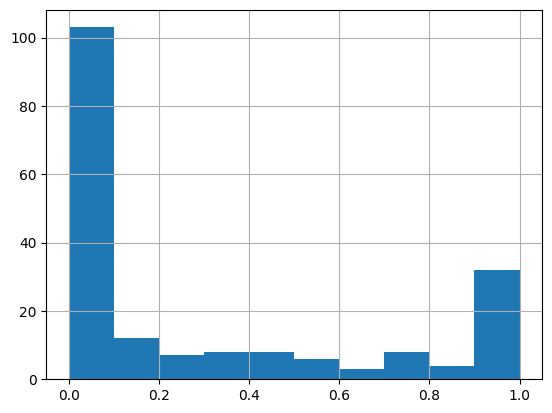

In [78]:
ol3['prop_setor'].hist()

Como a distribuição apresenta muitos valores abaixo de 0.1, vamos analisar esses casos visualmente para confirmar que fazem sentido.

In [79]:
filtro_intersecoes_pequenas = ol3['prop_setor']<=0.1
setores_02 = ol3.loc[filtro_intersecoes_pequenas, 'CD_SETOR'].tolist()
areas_risco_02 = ol3.loc[filtro_intersecoes_pequenas, 'id'].tolist()

In [80]:
# Criar o mapa com as camadas
m = df_censo[df_censo['CD_SETOR'].isin(setores_02)].explore(name='Setor Censitário')

m = df_geo[df_geo['id'].isin(areas_risco_02)].explore(
    m=m, color='orange', name='Área de Risco')

filtered_ol3 = ol3.loc[filtro_intersecoes_pequenas, ['id', 'CD_SETOR', 'geometry', 'prop_setor']]
m = filtered_ol3.explore(m=m, color='purple', name='Interseção')

LayerControl().add_to(m)

# Adicionar a legenda personalizada
legend_html = """
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 200px; height: 120px; 
            background-color: white; z-index:1000; padding: 10px; 
            border: 2px solid grey; border-radius: 5px;">
    <h4>Legenda</h4>
    <i style="background: orange; width: 10px; height: 10px; display: inline-block;"></i> Área de Risco<br>
    <i style="background: purple; width: 10px; height: 10px; display: inline-block;"></i> Interseção<br>
    <i style="background: blue; width: 10px; height: 10px; display: inline-block;"></i> Setor Censitário
</div>
"""
m.get_root().html.add_child(Element(legend_html))

m

A inspeção visual mostra que parte das interseções não aparentam ser significativas, mas não causarão distorção relevante no cálculo, devido ao fator de pontederação baixo. Outras, entretanto, aparentam ser significativas, mas se tratam de interseções pequenas em comparação com os setores censitários, ocorrendo principalmente em setores sensitários maiores.

#### Calculando a população

O primeiro passo é calcular a população correspondente a cada interseção.

In [81]:
ol3['pop_estimada'] = ol3['v0001']*ol3['prop_setor']

(
    ol3
    .loc[:, ['id','CD_SETOR','v0001', 'prop_setor', 'pop_estimada']]
    .sort_values('pop_estimada', ascending=False)
)

,id,CD_SETOR,v0001,prop_setor,pop_estimada
35,area_risco_geologico.296,355030830000390,801,0.990218,793.164550
36,area_risco_geologico.296,355030830000391,664,0.922273,612.388972
20,area_risco_geologico.250,355030830000259,705,0.798313,562.810866
37,area_risco_geologico.290,355030830000395,549,0.984930,540.726507
98,area_risco_geologico.296,355030830001214,617,0.826705,510.077191
...,...,...,...,...,...
160,area_risco_geologico.289,355030830001503,0,0.058633,0.000000
181,area_risco_geologico.296,355030830001598,0,0.041786,0.000000
188,area_risco_geologico.297,355030830001674,0,0.086180,0.000000
189,area_risco_geologico.296,355030830001683,0,0.001434,0.000000


Depois, calculamos a população agregada por área de risco.

In [82]:
area_risco_pop = (
    ol3
    .loc[:, ['id', 'pop_estimada']]
    .groupby('id')
    .sum()
    .round(0)
    .reset_index()
)

area_risco_pop['pop_estimada'] = area_risco_pop['pop_estimada'].astype(int)
area_risco_pop

,id,pop_estimada
0,area_risco_geologico.250,579
1,area_risco_geologico.251,553
2,area_risco_geologico.254,54
3,area_risco_geologico.257,332
4,area_risco_geologico.258,125
5,area_risco_geologico.259,235
6,area_risco_geologico.261,986
7,area_risco_geologico.262,1155
8,area_risco_geologico.268,36
9,area_risco_geologico.269,103


Finalmente, trazemos a coluna de população para o dataframe original.

In [88]:
df_geo_pop = df_geo.merge(
    area_risco_pop,
    how='inner'
)

df_geo_pop.head()

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,dt_vistoria,sg_fonte_original,qt_moradia,geometry,pop_estimada
0,area_risco_geologico.250,250,PARQUE SAO JOSE,AREA ENCERRADA,CS-06,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-06-01 03:00:00+00:00,2021-09-17,18,0,"POLYGON ((327461.667 7373432.183, 327462.06 73...",579
1,area_risco_geologico.251,251,PARQUE SAO JOSE II,AREA ENCERRADA,CS-07,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-06-01 03:00:00+00:00,2021-09-27,18,0,"POLYGON ((326971.339 7373085.231, 326973.38 73...",553
2,area_risco_geologico.254,254,JD. NORONHA II,AREA ENCERRADA,CS-34,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-06-01 03:00:00+00:00,2021-09-03,18,0,"POLYGON ((329227.101 7370337.94, 329240.04 737...",54
3,area_risco_geologico.257,257,JARDIM REIMBERG,r2,CS-39,CS-39-01 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2021-12-02,18,90,"POLYGON ((327107.276 7372618.526, 327074.391 7...",332
4,area_risco_geologico.258,258,JARDIM DOS MANACAS,r2,CS-25,CS-25-01 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2021-12-02,18,80,"POLYGON ((326834.355 7372669.605, 326890.151 7...",125


#### Visualizando a população

Para visualizar o resultado, vamos criar algumas visualizações. Primeiro, vamos criar dois *treemaps* por tipo de processo e grau de risco, alterando a ordem da hierarquia.

In [91]:
df_tree = (
    df_geo_pop
    .groupby(['tx_tipo_processo_geologico', 'tx_grau_de_risco_geologico'], as_index=False)
    ['pop_estimada']
    .sum()
)

df_tree

,tx_tipo_processo_geologico,tx_grau_de_risco_geologico,pop_estimada
0,ESCORREGAMENTO,AREA ENCERRADA,1186
1,ESCORREGAMENTO,r1,1739
2,ESCORREGAMENTO,r2,10055
3,ESCORREGAMENTO,r3,368
4,ESCORREGAMENTO,r4,56
5,ESCORREGAMENTO/SOLAPAMENTO,r1,1155
6,ESCORREGAMENTO/SOLAPAMENTO,r2,1008
7,SOLAPAMENTO,r1,376
8,SOLAPAMENTO,r2,641
9,SOLAPAMENTO,r3,963


In [90]:
# Criar o gráfico do tipo treeview
fig = px.treemap(
    df_tree,
    path=['tx_grau_de_risco_geologico', 'tx_tipo_processo_geologico'],  # Caminho hierárquico
    values='pop_estimada',               # Valores para o tamanho das caixas
    title='Somatório de População Estimada por Tipo de Processo Geológico'
)

# Exibir o gráfico
fig.show()

In [92]:
# Criar o gráfico do tipo treeview
fig = px.treemap(
    df_tree,
    path=['tx_tipo_processo_geologico', 'tx_grau_de_risco_geologico'],  # Caminho hierárquico
    values='pop_estimada',               # Valores para o tamanho das caixas
    title='Somatório de População Estimada por Tipo de Processo Geológico'
)

# Exibir o gráfico
fig.show()

Por último, vamos criar um mapa coroplético das áreas de risco, adicionando as camadas de setores censitários envolvidos, interseções envolvidas (e população atribuida) e adicionar também uma camada de satelite.

In [93]:

# Filtrar os setores censitários presentes em ol3
setores_presentes = df_censo[df_censo['CD_SETOR'].isin(ol3['CD_SETOR'].unique())]
# Adicionar os setores censitários ao mapa com apenas o contorno
m = setores_presentes.explore(
    color=None,  # Remove o preenchimento
    style_kwds={'fill': False, 'color': 'skyblue'},  # Define apenas o contorno azul
    name='Setores Censitários',
    tiles='CartoDB positron'  # Mapa base
)

# Criar o mapa base
m = df_geo_pop.explore(
    m=m,
    column='pop_estimada',  # Coluna para o mapa coroplético
    cmap='YlOrRd',          # Paleta de cores
    legend=True,            # Adicionar legenda
    legend_kwds={
        'caption': 'População total',
        'position': 'bottomright',  # Alterar posição da legenda
        'frameon': True             # Adicionar quadro de fundo
    },
    tooltip=['tx_grau_de_risco_geologico', 'tx_tipo_processo_geologico', 'pop_estimada'],  # Informações no tooltip
    name='Áreas de Risco'   # Nome da camada
)

# Adicionar as interseções ao mapa
m = ol3.explore(
    m=m,
    column='pop_estimada',  # Coluna para o mapa coroplético
    cmap='YlOrRd',          # Paleta de cores
    legend=True,            # Adicionar legenda
    legend_kwds={
        'caption': 'População parcial',
        'position': 'bottomright',  # Alterar posição da legenda
        'frameon': True             # Adicionar quadro de fundo
    },
    tooltip=['CD_SETOR', 'pop_estimada'],  # Informações no tooltip
    name='Interseções'      # Nome da camada
)

# Adicionar outra camada base (Google Satellite)
TileLayer(
    tiles='https://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}',
    attr='Google Satellite',
    name='Google Satellite'
).add_to(m)

# Adicionar controle de camadas
LayerControl(position='bottomleft').add_to(m)

# Exibir o mapa
m


In [42]:
m.save('plots/população em áreas de risco.html')

# Generalizando o cálculo para toda a cidade

Primeiro, vamos criar uma função genérica para fazer a interpolação da variável entre dois geodataframes.

In [95]:

def areal_weighted_interpolation(
        left: gpd.GeoDataFrame,
        right: gpd.GeoDataFrame,
        right_id_col: str,
        original_var_name: str,
        final_var_name: str = None):
    """
    Perform areal weighted interpolation between two GeoDataFrames.
    This function calculates the weighted interpolation of a variable from one GeoDataFrame (`left`) 
    to another GeoDataFrame (`right`) based on the proportion of intersection areas. It is commonly 
    used in spatial analysis to transfer data between different spatial units.
    Parameters:
    -----------
    left : gpd.GeoDataFrame
    The source GeoDataFrame containing the original spatial data and variable to be interpolated.
    right : gpd.GeoDataFrame
    The target GeoDataFrame to which the interpolated variable will be transferred.
    right_id_col : str
    The column name in the `right` GeoDataFrame that uniquely identifies spatial units.
    original_var_name : str
    The column name in the `left` GeoDataFrame containing the variable to be interpolated.
    final_var_name : str, optional
    The column name for the interpolated variable in the resulting GeoDataFrame. 
    If not provided, the `original_var_name` will be used.
    Returns:
    --------
    final_gdf : gpd.GeoDataFrame
    A GeoDataFrame containing the `right` GeoDataFrame with the interpolated variable added.
    Notes:
    ------
    - The function assumes that both GeoDataFrames use the same coordinate reference system (CRS).
    - The intersection areas are calculated using the `gpd.overlay` method with `how='intersection'`.
    - The interpolated variable is calculated as the product of the original variable and the 
        proportion of intersection area relative to the total area of the `left` GeoDataFrame.
    Example:
    --------
    >>> interpolated_gdf = areal_weighted_interpolation(
        left=source_gdf,
        right=target_gdf,
        right_id_col='region_id',
        original_var_name='population',
        final_var_name='interpolated_population'
    >>> interpolated_gdf.head()
    """

    left = left.copy()
    right = right.copy()

    left['total_area'] = left.area

    inter = gpd.overlay(
        left,
        right,
        how='intersection',
        keep_geom_type=True)

    inter['intersection_area'] = inter.area

    inter['inter_prop'] = inter['intersection_area']/inter['total_area']

    if not final_var_name:
        final_var_name = original_var_name

    inter[final_var_name] = inter[original_var_name]*inter['inter_prop']

    right_interpolated = (
        inter
        .loc[:, [right_id_col, final_var_name]]
        .groupby(right_id_col)
        .sum()
        .round(0)
        .reset_index()
    )

    right_interpolated[final_var_name] = right_interpolated[final_var_name].astype(int)
    right_interpolated

    final_gdf = right.merge(
        right_interpolated,
        how='inner',
        on=right_id_col
    )
    
    return final_gdf

Agora, preparamos uma função para calcular os polígonos ajusados de todos os setores censitários da cidade.

In [98]:
def prepare_tracts():

    ol1 = gpd.overlay(df_censo, df_veg,
                    how='difference',
                    keep_geom_type=True)

    ol2 = (
        gpd.overlay(ol1, df_quadras[['geometry']],
                    how='intersection',
                    keep_geom_type=True)
            .dissolve(by='CD_SETOR', aggfunc='first')
            .reset_index()
    )

    ol2['area_setor_ajustado'] = ol2.area
    
    return ol2

## Preparando os setores censitários

In [99]:
df_censo_ajustado = prepare_tracts()
df_censo_ajustado.head()

,CD_SETOR,geometry,SITUACAO,CD_SIT,CD_TIPO,AREA_KM2,CD_REGIAO,NM_REGIAO,CD_UF,NM_UF,...,CD_CONCURB,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,area_setor_ajustado
0,355030801000001,"MULTIPOLYGON (((339690.308 7392676.463, 339690...",Urbana,1,0,0.071797,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,682,329,329,0,2.4,0.0381,289,53835.196205
1,355030801000002,"MULTIPOLYGON (((339928.608 7392728.179, 339928...",Urbana,1,0,0.071902,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,1374,1011,1011,0,2.3,0.0150,599,51627.993801
2,355030801000003,"MULTIPOLYGON (((339976.555 7392432.368, 339977...",Urbana,1,0,0.055681,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,557,239,238,1,2.7,0.0927,205,40818.436977
3,355030801000004,"MULTIPOLYGON (((339882.544 7392560.093, 339882...",Urbana,1,0,0.064905,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,526,245,245,0,2.4,0.0136,221,50289.761982
4,355030801000005,"MULTIPOLYGON (((339673.647 7392190.559, 339669...",Urbana,1,0,0.086822,3,Sudeste,35,São Paulo,...,3550308,São Paulo/SP,579,258,258,0,2.6,0.0905,221,60598.289433


## Calculando a população para risco hidrológico

Com os setores censitários ajustados, vamos calcular a população para as áreas de risco hidrológico.

In [100]:
df_hid.columns

Index(['id', 'cd_identificador_risco_hidrologico', 'nm_area_risco_hidrologico',
       'tx_grau_risco_hidrologico', 'sg_area_risco_hidrologico',
       'sg_setor_risco_hidrologico', 'tx_tipo_processo', 'dt_vistoria',
       'qt_moradia', 'nm_subprefeitura', 'nm_bacia_hidrografica', 'geometry'],
      dtype='object')

In [101]:
df_hid_pop = areal_weighted_interpolation(
    df_censo_ajustado,
    df_hid,
    'id',
    'v0001',
    'populacao_estimada'
)

df_hid_pop.head()

,id,cd_identificador_risco_hidrologico,nm_area_risco_hidrologico,tx_grau_risco_hidrologico,sg_area_risco_hidrologico,sg_setor_risco_hidrologico,tx_tipo_processo,dt_vistoria,qt_moradia,nm_subprefeitura,nm_bacia_hidrografica,geometry,populacao_estimada
0,risco_hidrologico.1,1,BARTOLOMEU FEIO,R2,HPI-01,HPI-01-01 (R2),ALAGAMENTO,2021-08-24,44,PINHEIROS,CORREGO AGUA ESPRAIADA,"POLYGON ((327424.845 7387319.281, 327417.205 7...",34
1,risco_hidrologico.2,2,SAO SAVERIO,R1,HIP-02,HIP-02-02 (R1),ENCHENTE/INUNDACAO,2022-01-20,100,IPIRANGA,CORREGO OURIVES-RIBEIRAO DOS COUROS,"POLYGON ((336127.973 7383089.854, 336129.964 7...",101
2,risco_hidrologico.3,3,SAO SAVERIO,R2,HIP-02,HIP-02-01 (R2),ALAGAMENTO/ENXURRADA,2022-01-20,55,IPIRANGA,CORREGO OURIVES-RIBEIRAO DOS COUROS,"POLYGON ((336230.18 7383173.982, 336238.655 73...",48
3,risco_hidrologico.4,4,MONTE KEMEL,R2,HIP-03,HIP-03-01 (R2),ALAGAMENTO/ENCHENTE/INUNDACAO,2022-02-09,14,IPIRANGA,CORREGO IPIRANGA,"POLYGON ((334072.936 7385682.328, 334069.133 7...",7
4,risco_hidrologico.5,5,NOVA IMIGRANTES,R2,HIP-04,HIP-04-01 (R2),ALAGAMENTO/ENCHENTE/INUNDACAO,2022-02-09,17,IPIRANGA,CORREGO IPIRANGA,"POLYGON ((333911.31 7386187.091, 333909.968 73...",43


In [ ]:
df_hid_final = areal_weighted_interpolation(
    df_censo_ajustado,
    df_hid_pop,
    'id',
    'v0002',
    'total_domicilios_estimado'
)

df_hid_final.head()

,id,cd_identificador_risco_hidrologico,nm_area_risco_hidrologico,tx_grau_risco_hidrologico,sg_area_risco_hidrologico,sg_setor_risco_hidrologico,tx_tipo_processo,dt_vistoria,qt_moradia,nm_subprefeitura,nm_bacia_hidrografica,geometry,populacao_estimada,total_domicilios_estimado
0,risco_hidrologico.1,1,BARTOLOMEU FEIO,R2,HPI-01,HPI-01-01 (R2),ALAGAMENTO,2021-08-24,44,PINHEIROS,CORREGO AGUA ESPRAIADA,"POLYGON ((327424.845 7387319.281, 327417.205 7...",34,15
1,risco_hidrologico.2,2,SAO SAVERIO,R1,HIP-02,HIP-02-02 (R1),ENCHENTE/INUNDACAO,2022-01-20,100,IPIRANGA,CORREGO OURIVES-RIBEIRAO DOS COUROS,"POLYGON ((336127.973 7383089.854, 336129.964 7...",101,40
2,risco_hidrologico.3,3,SAO SAVERIO,R2,HIP-02,HIP-02-01 (R2),ALAGAMENTO/ENXURRADA,2022-01-20,55,IPIRANGA,CORREGO OURIVES-RIBEIRAO DOS COUROS,"POLYGON ((336230.18 7383173.982, 336238.655 73...",48,18
3,risco_hidrologico.4,4,MONTE KEMEL,R2,HIP-03,HIP-03-01 (R2),ALAGAMENTO/ENCHENTE/INUNDACAO,2022-02-09,14,IPIRANGA,CORREGO IPIRANGA,"POLYGON ((334072.936 7385682.328, 334069.133 7...",7,4
4,risco_hidrologico.5,5,NOVA IMIGRANTES,R2,HIP-04,HIP-04-01 (R2),ALAGAMENTO/ENCHENTE/INUNDACAO,2022-02-09,17,IPIRANGA,CORREGO IPIRANGA,"POLYGON ((333911.31 7386187.091, 333909.968 73...",43,15


## Calculando a população para risco geológico

Com os setores censitários ajustados, vamos calcular a população para as áreas de risco geológico.

In [104]:
df_geo.columns

Index(['id', 'cd_identificador', 'nm_area_risco', 'tx_grau_de_risco_geologico',
       'sg_area_risco', 'sg_setor_risco', 'tx_tipo_processo_geologico',
       'cd_tipo_processo_geologico', 'cd_grau_risco_geologico',
       'dt_atualizacao', 'dt_vistoria', 'sg_fonte_original', 'qt_moradia',
       'geometry'],
      dtype='object')

In [105]:
df_geo_pop = areal_weighted_interpolation(
    df_censo_ajustado,
    df_geo,
    'id',
    'v0001',
    'populacao_estimada'
)

df_geo_pop.head()

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,dt_vistoria,sg_fonte_original,qt_moradia,geometry,populacao_estimada
0,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-06-01 03:00:00+00:00,2022-02-02,18,0,"POLYGON ((332306.817 7380115.28, 332246.187 73...",2361
1,area_risco_geologico.2,2,AVENIDA SANTO AFONSO III,r2,AD-03,AD-03-02 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-02,18,3,"POLYGON ((332093.382 7380021.902, 332083.988 7...",13
2,area_risco_geologico.3,3,AVENIDA SANTO AFONSO III,r1,AD-03,AD-03-01 (R1),ESCORREGAMENTO,2,1,2025-06-01 03:00:00+00:00,2022-02-02,18,80,"POLYGON ((332072.887 7379996.732, 332028.543 7...",261
3,area_risco_geologico.4,4,RUA SAO BENTO XV,r3,AD-04,AD-04-03 (R3),SOLAPAMENTO,4,3,2025-06-01 03:00:00+00:00,2024-03-27,18,100,"POLYGON ((332324.725 7378882.633, 332309.159 7...",219
4,area_risco_geologico.5,5,RUA SAO BENTO XV,r3,AD-04,AD-04-01 (R3),SOLAPAMENTO,4,3,2025-06-01 03:00:00+00:00,2024-03-27,18,30,"POLYGON ((332060.389 7379330.535, 332080.779 7...",68


In [106]:
df_geo_final = areal_weighted_interpolation(
    df_censo_ajustado,
    df_geo_pop,
    'id',
    'v0002',
    'total_domicilios_estimado'
)

df_geo_final.head()

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,dt_vistoria,sg_fonte_original,qt_moradia,geometry,populacao_estimada,total_domicilios_estimado
0,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-06-01 03:00:00+00:00,2022-02-02,18,0,"POLYGON ((332306.817 7380115.28, 332246.187 73...",2361,881
1,area_risco_geologico.2,2,AVENIDA SANTO AFONSO III,r2,AD-03,AD-03-02 (R2),ESCORREGAMENTO,2,2,2025-06-01 03:00:00+00:00,2022-02-02,18,3,"POLYGON ((332093.382 7380021.902, 332083.988 7...",13,6
2,area_risco_geologico.3,3,AVENIDA SANTO AFONSO III,r1,AD-03,AD-03-01 (R1),ESCORREGAMENTO,2,1,2025-06-01 03:00:00+00:00,2022-02-02,18,80,"POLYGON ((332072.887 7379996.732, 332028.543 7...",261,110
3,area_risco_geologico.4,4,RUA SAO BENTO XV,r3,AD-04,AD-04-03 (R3),SOLAPAMENTO,4,3,2025-06-01 03:00:00+00:00,2024-03-27,18,100,"POLYGON ((332324.725 7378882.633, 332309.159 7...",219,91
4,area_risco_geologico.5,5,RUA SAO BENTO XV,r3,AD-04,AD-04-01 (R3),SOLAPAMENTO,4,3,2025-06-01 03:00:00+00:00,2024-03-27,18,30,"POLYGON ((332060.389 7379330.535, 332080.779 7...",68,27


# Exportando os arquivos

Finalmente, salvamos os arquivos com as camadas com os totais de população e domicílios.

In [114]:
output_dir = path.join('data_output', 'urbanismo')

for c, gdf in [('risco_hidrologico', df_hid_final),
               ('risco_geologico', df_geo_final)]:
    filename=path.join(output_dir, c)
    gdf.to_file(f'{filename}.gpkg', driver='GPKG', layer=c)